# Jungler Pathing in High Elo Games

Goal: create a heatmap based on where the jungler for each side will most likely be throughout the game.

Purpose: Be better at assuming where an enemy jungler will be at any given minute in a game.

Assumption(s): Early game (0-~8 minutes) will have better data than later game (when laning phase ends), since in-game victory objectives begin to become more volatile the more time goes on.


# Dataset: combined_interpolated_data.csv

In [4]:
import pandas as pd


df = pd.read_csv('./datasets/leagueoflegends/combined_interpolated_data.csv')
df.head() #first 5 lines of csv

,MatchID,Time,Player1_X,Player1_Y,Player2_X,Player2_Y,Player3_X,Player3_Y,Player4_X,Player4_Y,...,Distance_6_8,Distance_6_9,Distance_6_10,Distance_7_8,Distance_7_9,Distance_7_10,Distance_8_9,Distance_8_10,Distance_9_10,Teamfight
0,NA1_4647454701,0,554.000000,581.000000,593.00,464.000000,557.000000,345.000000,458.000000,271.00,...,236.019067,324.524267,381.188930,124.326184,235.529191,323.402226,123.600162,234.648674,123.016259,0
1,NA1_4647454701,1,596.566667,751.083333,753.55,576.266667,663.883333,455.516667,594.266667,340.75,...,317.620765,398.464944,352.764776,114.265467,208.005594,212.190015,102.462882,161.464004,120.356600,0
2,NA1_4647454701,2,639.133333,921.166667,914.10,688.533333,770.766667,566.033333,730.533333,410.50,...,425.035137,538.710973,422.569696,133.519741,247.509813,144.642352,120.403636,88.876494,130.992536,0
3,NA1_4647454701,3,681.700000,1091.250000,1074.65,800.800000,877.650000,676.550000,866.800000,480.25,...,543.158128,706.839163,554.681424,172.539191,330.844892,179.664750,165.142908,23.349946,152.161099,0
4,NA1_4647454701,4,724.266667,1261.333333,1235.20,913.066667,984.533333,787.066667,1003.066667,550.00,...,666.318696,887.136169,715.375420,221.095796,433.425923,281.244804,220.961706,63.318174,180.187618,0


# Testing dataframes

In [5]:
player1 = df[df["MatchID"] == "NA1_4647454701"][["Player1_X","Player1_Y"]]
player2 = df[df["MatchID"] == "NA1_4647454701"][["Player2_X","Player2_Y"]]
print(player1)

         Player1_X     Player1_Y
0       554.000000    581.000000
1       596.566667    751.083333
2       639.133333    921.166667
3       681.700000   1091.250000
4       724.266667   1261.333333
...            ...           ...
2276  12559.000000  13028.400000
2277  12625.750000  13029.800000
2278  12692.500000  13031.200000
2279  12759.250000  13032.600000
2280  12826.000000  13034.000000

[2281 rows x 2 columns]


# Find Unique Match ID:

In [6]:
uniqueMatchID = df.MatchID.unique()
print(uniqueMatchID)

['NA1_4647454701' 'NA1_4645483939' 'NA1_4598230327' 'NA1_4645309816'
 'NA1_4656152813' 'NA1_4638745154' 'NA1_4643089224' 'NA1_4615565612'
 'NA1_4657777097' 'NA1_4646681514' 'NA1_4645234515' 'NA1_4598324711'
 'NA1_4649185990' 'NA1_4648944767' 'NA1_4648052410' 'NA1_4648390957'
 'NA1_4646423955' 'NA1_4646491566' 'NA1_4644444434' 'NA1_4643993824'
 'NA1_4641811159' 'NA1_4640661873' 'NA1_4646705052' 'NA1_4646708615'
 'NA1_4654339825' 'NA1_4597474294' 'NA1_4641455049' 'NA1_4656960086'
 'NA1_4646675896' 'NA1_4647204793' 'NA1_4649132104' 'NA1_4599742776'
 'NA1_4647097967' 'NA1_4645727097' 'NA1_4646187313' 'NA1_4656769721'
 'NA1_4649341904' 'NA1_4644465188' 'NA1_4644122211' 'NA1_4643048817'
 'NA1_4596989546' 'NA1_4654406885' 'NA1_4644032493' 'NA1_4599447028'
 'NA1_4640560641' 'NA1_4644925727' 'NA1_4647372737' 'NA1_4645337633'
 'NA1_4644981295' 'NA1_4640502501' 'NA1_4643293822' 'NA1_4643019589'
 'NA1_4599696650' 'NA1_4647267754' 'NA1_4620465375' 'NA1_4645850487'
 'NA1_4627554999' 'NA1_4599996001'

In [7]:
import numpy as np


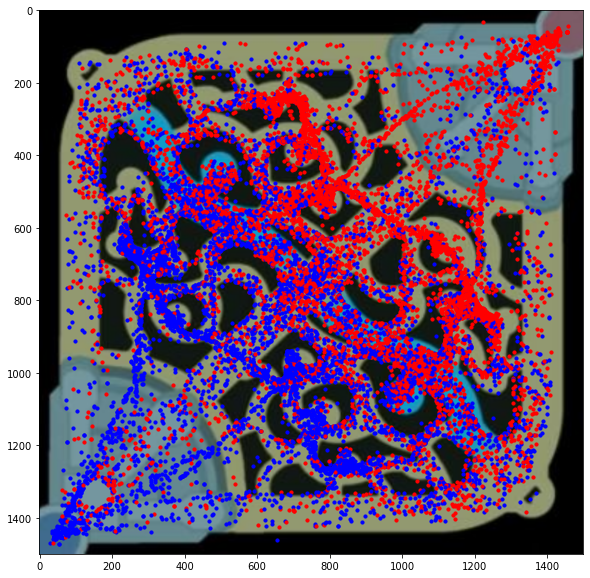

In [8]:
#Stats
import matplotlib.pyplot as plt
import cv2
from colour import Color

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))
plt.figure(figsize=(10,10))
plt.imshow(rbgimgresized)
firstFlag = True
for match in uniqueMatchID:
    # print(match)
    jungler1 = df[df["MatchID"] == match][["Player2_X","Player2_Y"]]
    jungler2 = df[df["MatchID"] == match][["Player7_X","Player7_Y"]]
    jungler1_X = jungler1["Player2_X"].values/10
    jungler1_X = jungler1_X[::60]
    jungler1_Y = 1500 - (jungler1["Player2_Y"].values/10)
    jungler1_Y = jungler1_Y[::60]
    plt.scatter(jungler1_X, jungler1_Y, c = "b", s = 10)
    # separate
    jungler1_X = jungler2["Player7_X"].values/10
    jungler2_X = jungler2_X[::60]
    jungler2_Y = 1500 - (jungler2["Player7_Y"].values/10)
    jungler2_Y = jungler2_Y[::60]
    plt.scatter(jungler2_X, jungler2_Y, c = "r", s = 10)
    


    
    


# Raw Scatterplots of Different Times

[TODO]

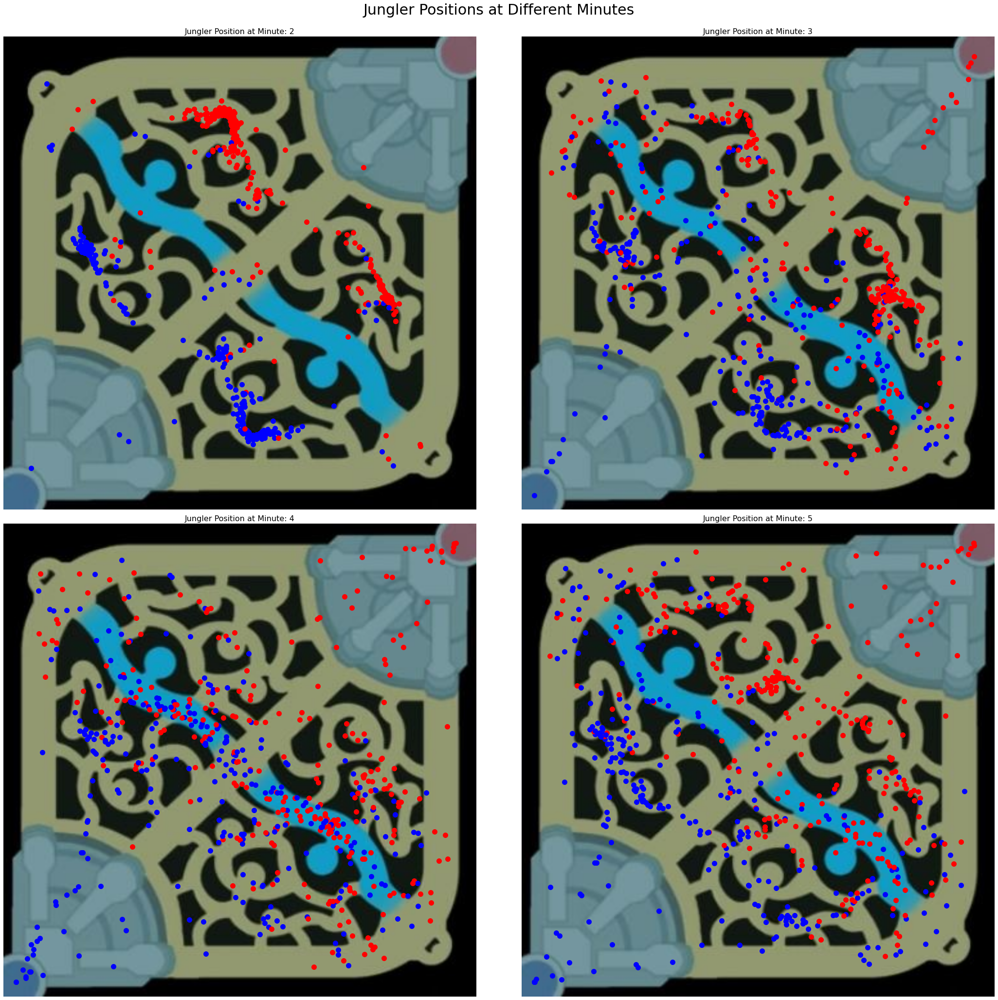

In [9]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [2, 3, 4, 5]
# 2 is 3 minutes, 3 is 4 minutes, etc.

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in uniqueMatchID:
            jungler1 = df[df["MatchID"] == match][["Player2_X", "Player2_Y"]]
            jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]
            jungler1_X = jungler1["Player2_X"].values / 10
            jungler1_X = jungler1_X[::60]
            jungler1_Y = 1500 - (jungler1["Player2_Y"].values / 10)
            jungler1_Y = jungler1_Y[::60]

            jungler2_X = jungler2["Player7_X"].values / 10
            jungler2_X = jungler2_X[::60]
            jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
            jungler2_Y = jungler2_Y[::60]

            # Ensure the index is within bounds
            #len(jungler1_x) shows the number of positions for each minute recorded in the game
            if minute < len(jungler1_X):
                # Get data for the specific minute
                jungler1_X_minute = jungler1_X[minute]
                jungler1_Y_minute = jungler1_Y[minute]
                ax.scatter(jungler1_X_minute, jungler1_Y_minute, c="b", s=100)

                jungler2_X_minute = jungler2_X[minute]
                jungler2_Y_minute = jungler2_Y[minute]
                ax.scatter(jungler2_X_minute, jungler2_Y_minute, c="r", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

# Blue Side Tracking

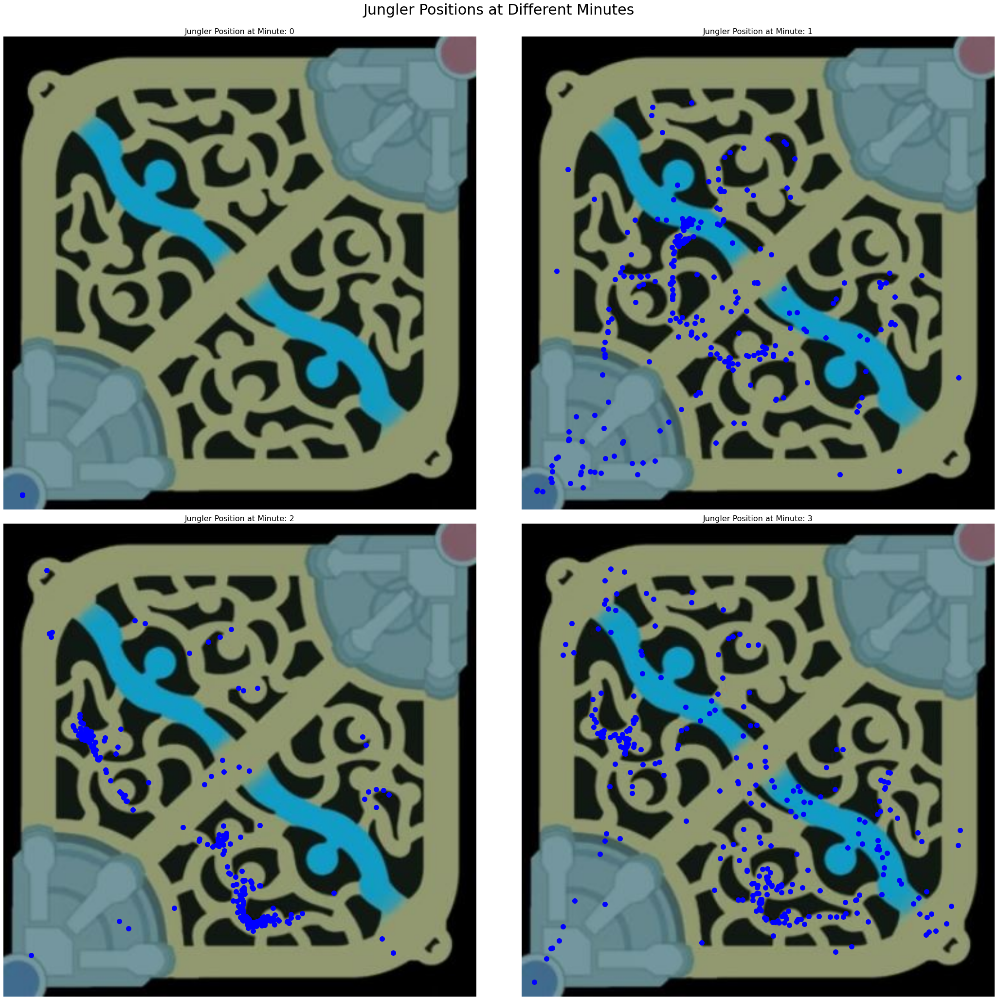

In [10]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [0, 1, 2, 3]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in uniqueMatchID:
            jungler1 = df[df["MatchID"] == match][["Player2_X", "Player2_Y"]]

            jungler1_X = jungler1["Player2_X"].values / 10
            jungler1_X = jungler1_X[::60]
            jungler1_Y = 1500 - (jungler1["Player2_Y"].values / 10)
            jungler1_Y = jungler1_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler1_X):
                # Get data for the specific minute
                jungler1_X_minute = jungler1_X[minute]
                jungler1_Y_minute = jungler1_Y[minute]
                ax.scatter(jungler1_X_minute, jungler1_Y_minute, c="b", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

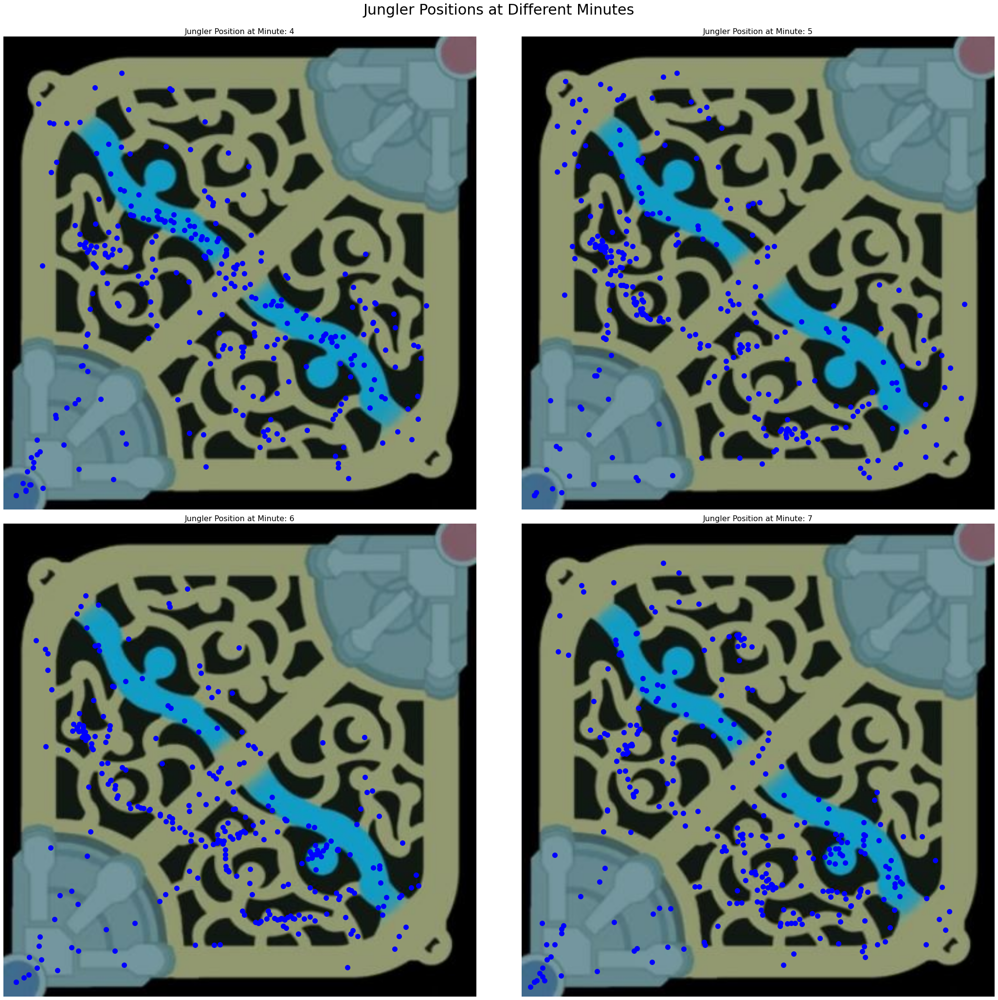

In [11]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [4, 5, 6, 7]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in uniqueMatchID:
            jungler1 = df[df["MatchID"] == match][["Player2_X", "Player2_Y"]]

            jungler1_X = jungler1["Player2_X"].values / 10
            jungler1_X = jungler1_X[::60]
            jungler1_Y = 1500 - (jungler1["Player2_Y"].values / 10)
            jungler1_Y = jungler1_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            
            if minute < len(jungler1_X):
                # Get data for the specific minute
                jungler1_X_minute = jungler1_X[minute]
                jungler1_Y_minute = jungler1_Y[minute]
                ax.scatter(jungler1_X_minute, jungler1_Y_minute, c="b", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

# Red Side Tracking

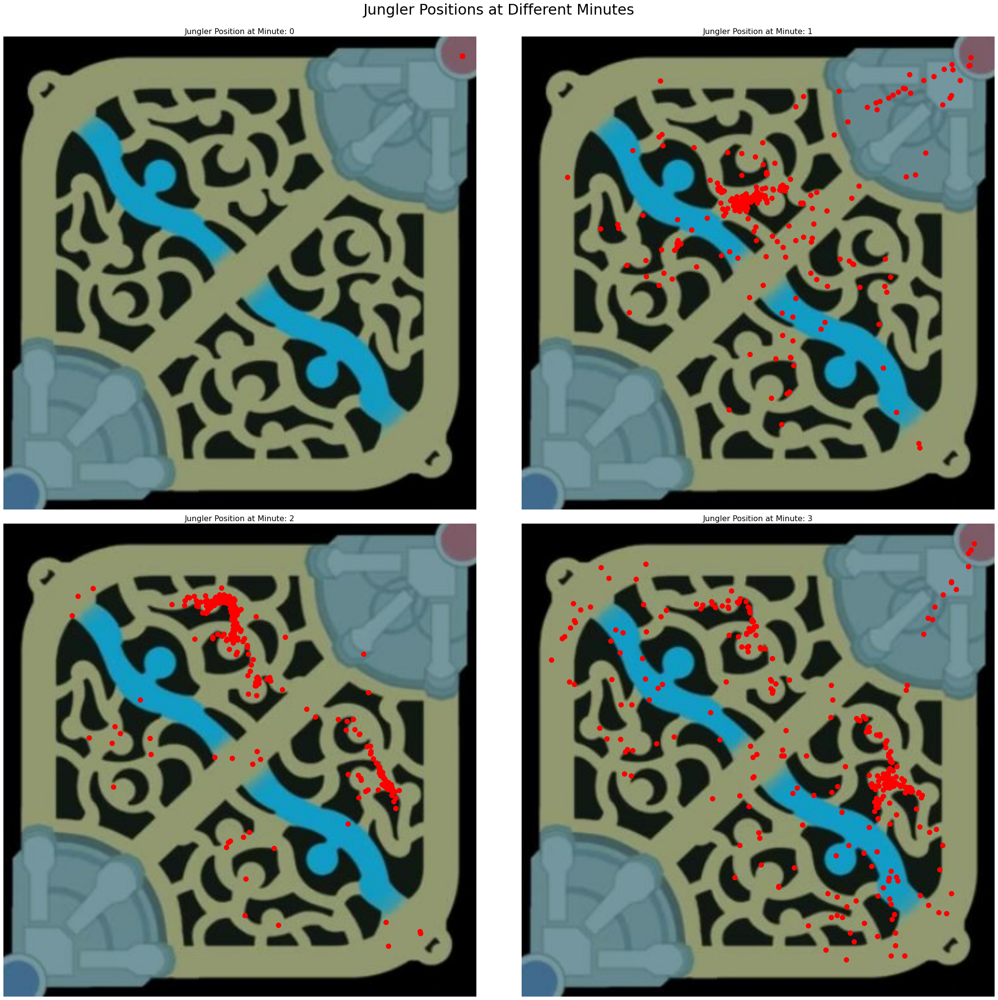

In [12]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [0, 1, 2, 3]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in uniqueMatchID:
            jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]

            jungler2_X = jungler2["Player7_X"].values / 10
            jungler2_X = jungler2_X[::60]
            jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
            jungler2_Y = jungler2_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler2_X):
                # Get data for the specific minute
                jungler2_X_minute = jungler2_X[minute]
                jungler2_Y_minute = jungler2_Y[minute]
                ax.scatter(jungler2_X_minute, jungler2_Y_minute, c="r", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

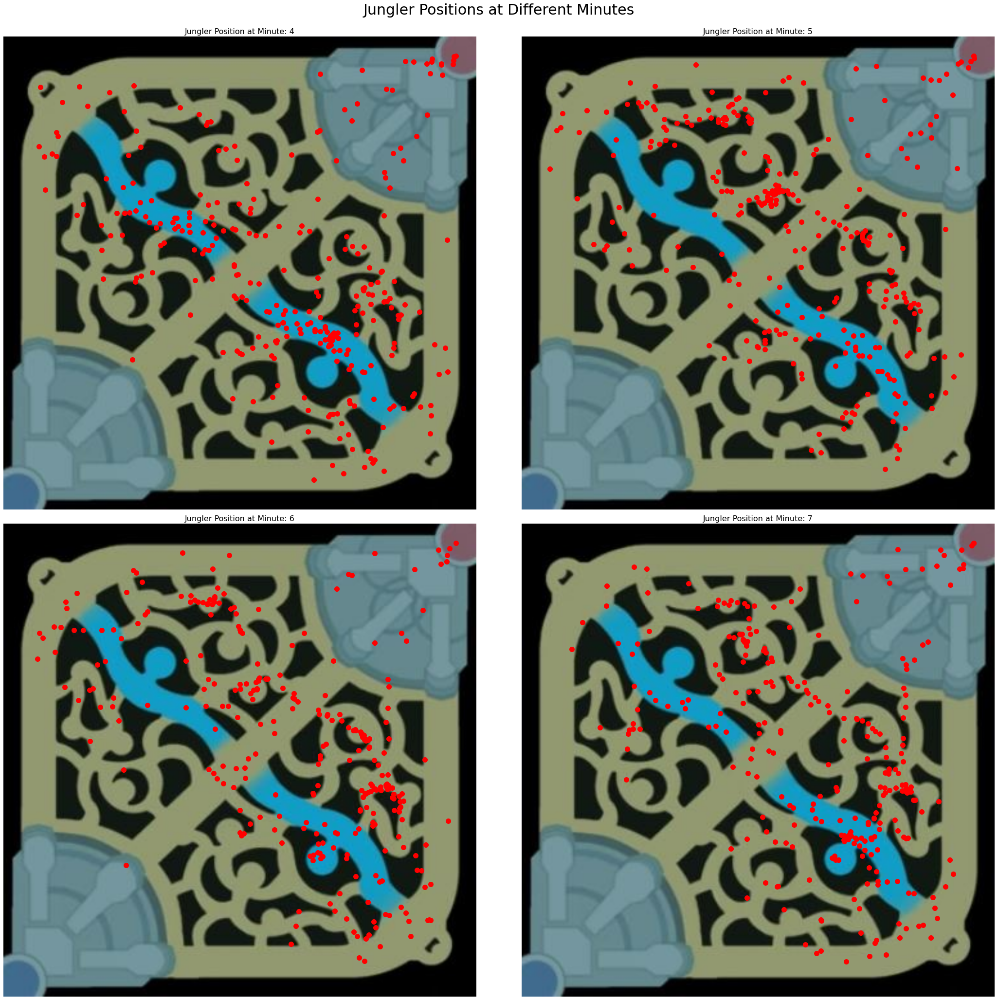

In [13]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [4, 5, 6, 7]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in uniqueMatchID:
            jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]

            jungler2_X = jungler2["Player7_X"].values / 10
            jungler2_X = jungler2_X[::60]
            jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
            jungler2_Y = jungler2_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler2_X):
                # Get data for the specific minute
                jungler2_X_minute = jungler2_X[minute]
                jungler2_Y_minute = jungler2_Y[minute]
                ax.scatter(jungler2_X_minute, jungler2_Y_minute, c="r", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

# Location Based on Jungling Path
Assuming that all jungler players above the middle lane at 2 minutes started at the top side and all jungler players below the middle lane at 2 minutes started at the bottom side.

Blue Top
129
Red Top
195
Blue Bot
158
Red Bot
92


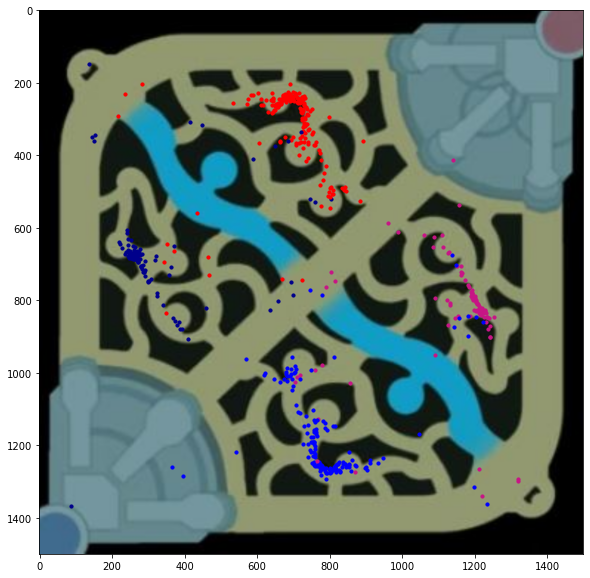

In [14]:


import matplotlib.pyplot as plt
import cv2
from colour import Color

b_top_side_matchID = []
b_bot_side_matchID = []
r_top_side_matchID = []
r_bot_side_matchID = []

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))
plt.figure(figsize=(10,10))
plt.imshow(rbgimgresized)


for match in uniqueMatchID:

    #if y > x: topside
    #if y < x: botside
    jungler1 = df[df["MatchID"] == match][["Player2_X","Player2_Y"]]
    jungler2 = df[df["MatchID"] == match][["Player7_X","Player7_Y"]]

    jungler1_X = jungler1["Player2_X"].values/10
    jungler1_X = jungler1_X[::60]
    jungler1_Y = 1500 - (jungler1["Player2_Y"].values/10)
    jungler1_Y = jungler1_Y[::60]
    # separate
    jungler2_X = jungler2["Player7_X"].values/10
    jungler2_X = jungler2_X[::60]
    jungler2_Y = 1500 - (jungler2["Player7_Y"].values/10)
    jungler2_Y = jungler2_Y[::60]
    
    if jungler1_Y[2] < (1500 - jungler1_X[2]):
        b_top_side_matchID.append(match)
        plt.scatter(jungler1_X[2], jungler1_Y[2], c = "darkblue", s = 10)
    else:
        b_bot_side_matchID.append(match)
        plt.scatter(jungler1_X[2], jungler1_Y[2], c = "b", s = 10)

    if jungler2_Y[2] < (1500 - jungler2_X[2]):
        r_top_side_matchID.append(match)
        plt.scatter(jungler2_X[2], jungler2_Y[2], c = "r", s = 10)
    else:
        r_bot_side_matchID.append(match)
        plt.scatter(jungler2_X[2], jungler2_Y[2], c = "mediumvioletred", s = 10)

print ("Blue Top")
print (len(b_top_side_matchID))
print ("Red Top")
print (len(r_top_side_matchID))
print ("Blue Bot")
print (len(b_bot_side_matchID))
print ("Red Bot")
print (len(r_bot_side_matchID))

# Blue Side Jungler Starting Position

## Blue Side Jungler Starting at Top Side

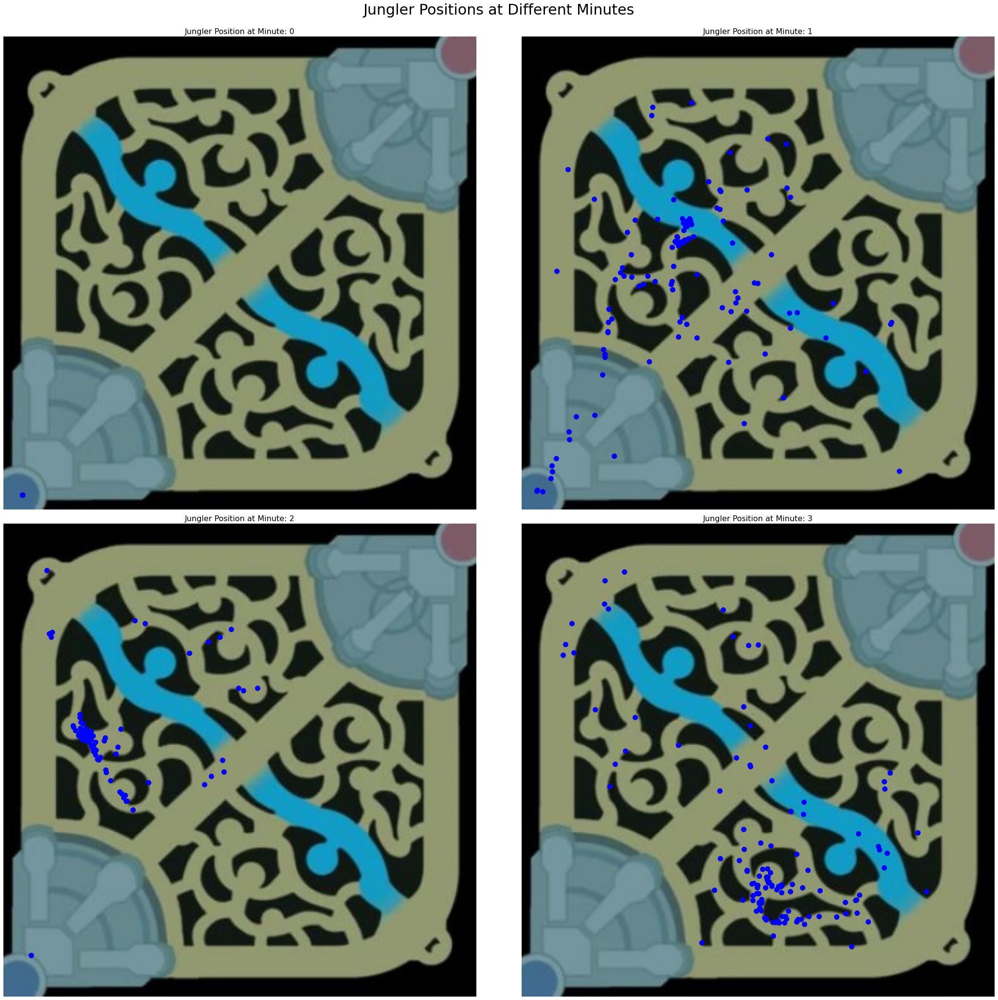

In [15]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [0, 1, 2, 3]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in b_top_side_matchID:
            jungler1 = df[df["MatchID"] == match][["Player2_X", "Player2_Y"]]

            jungler1_X = jungler1["Player2_X"].values / 10
            jungler1_X = jungler1_X[::60]
            jungler1_Y = 1500 - (jungler1["Player2_Y"].values / 10)
            jungler1_Y = jungler1_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler1_X):
                # Get data for the specific minute
                jungler1_X_minute = jungler1_X[minute]
                jungler1_Y_minute = jungler1_Y[minute]
                ax.scatter(jungler1_X_minute, jungler1_Y_minute, c="b", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

## Blue Side Jungler Starting at Bottom Side

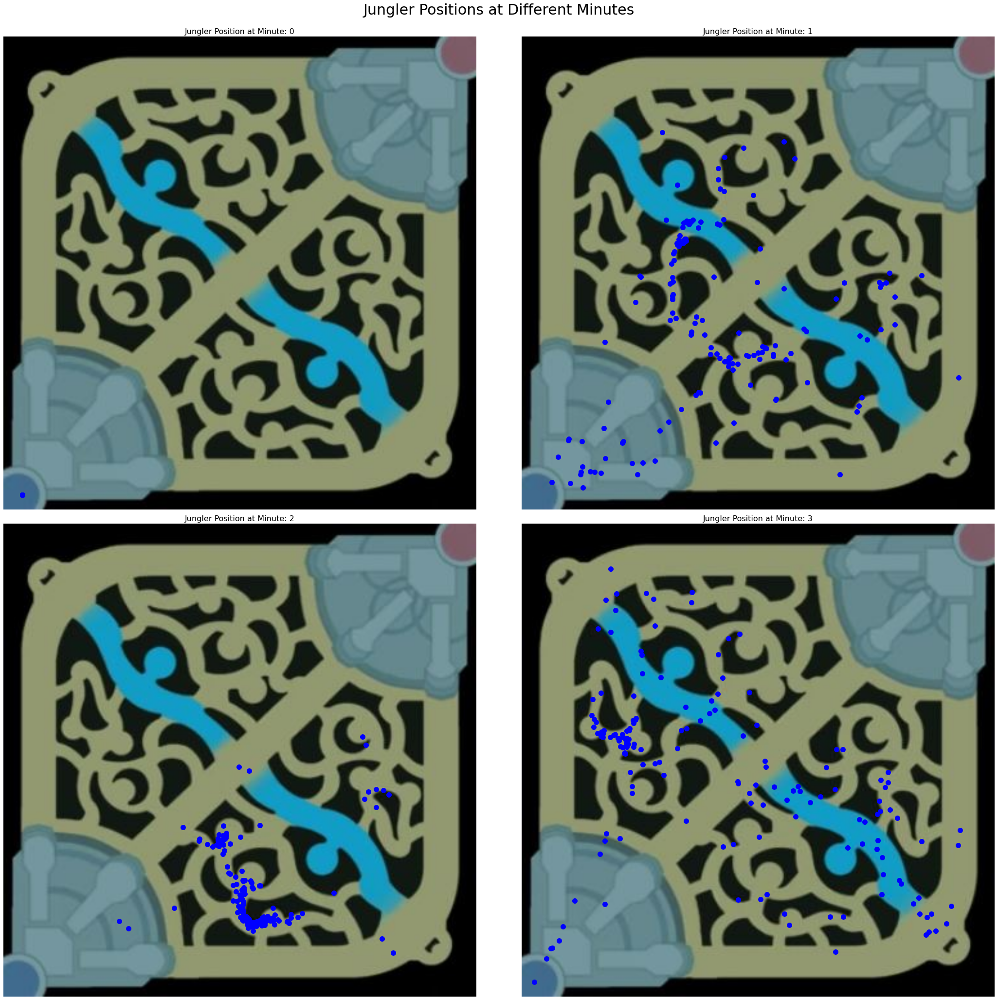

In [16]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [0, 1, 2, 3]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in b_bot_side_matchID:
            jungler1 = df[df["MatchID"] == match][["Player2_X", "Player2_Y"]]

            jungler1_X = jungler1["Player2_X"].values / 10
            jungler1_X = jungler1_X[::60]
            jungler1_Y = 1500 - (jungler1["Player2_Y"].values / 10)
            jungler1_Y = jungler1_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler1_X):
                # Get data for the specific minute
                jungler1_X_minute = jungler1_X[minute]
                jungler1_Y_minute = jungler1_Y[minute]
                ax.scatter(jungler1_X_minute, jungler1_Y_minute, c="b", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

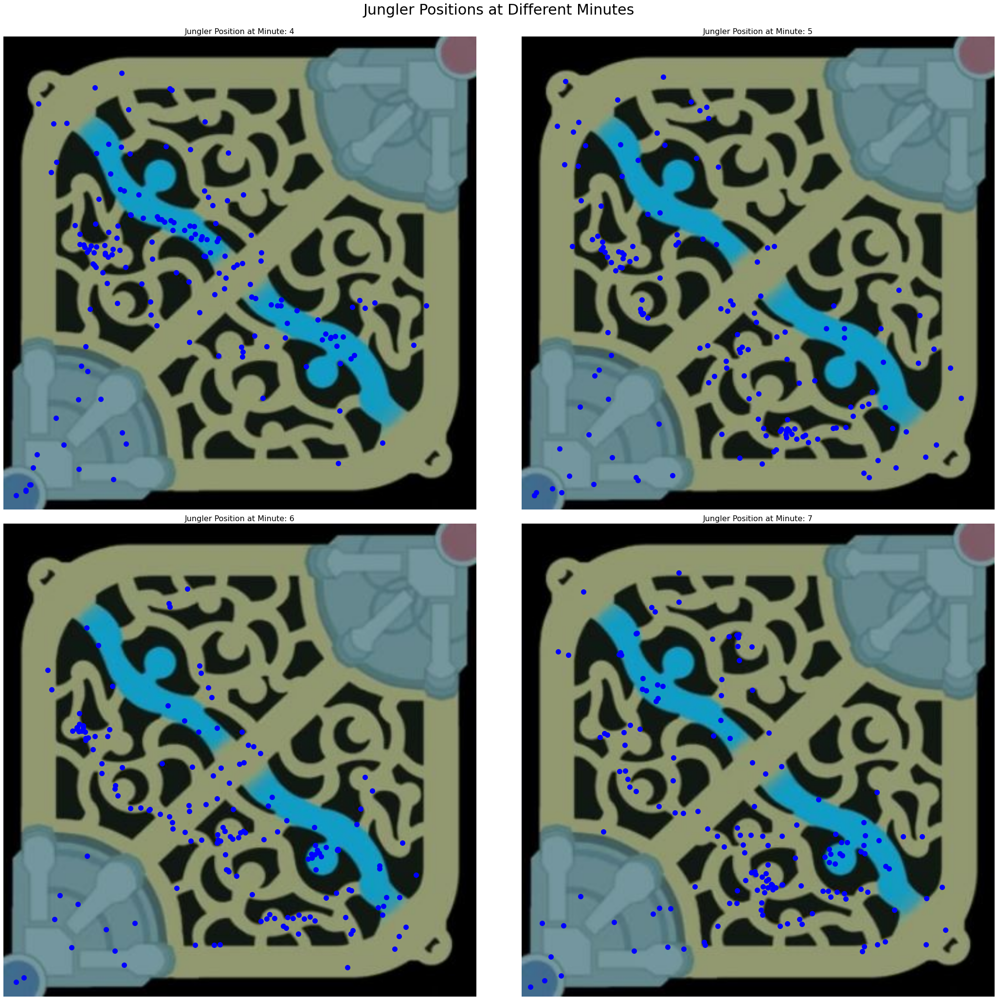

In [17]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [4, 5, 6, 7]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in b_bot_side_matchID:
            jungler1 = df[df["MatchID"] == match][["Player2_X", "Player2_Y"]]

            jungler1_X = jungler1["Player2_X"].values / 10
            jungler1_X = jungler1_X[::60]
            jungler1_Y = 1500 - (jungler1["Player2_Y"].values / 10)
            jungler1_Y = jungler1_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler1_X):
                # Get data for the specific minute
                jungler1_X_minute = jungler1_X[minute]
                jungler1_Y_minute = jungler1_Y[minute]
                ax.scatter(jungler1_X_minute, jungler1_Y_minute, c="b", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

# Red Side Jungler Starting Position

## Red Side Jungler Starting at Top Side
Minute 0 to 7

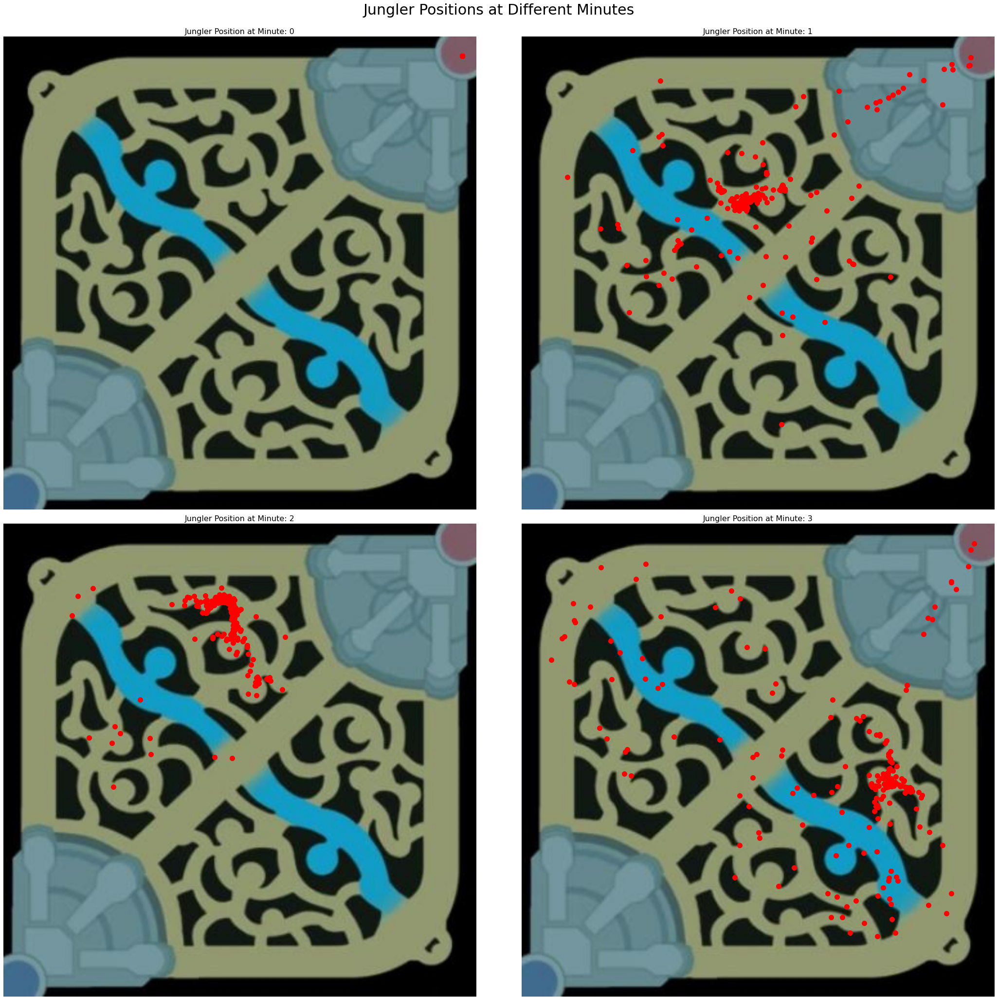

In [18]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [0, 1, 2, 3]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in r_top_side_matchID:
            jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]

            jungler2_X = jungler2["Player7_X"].values / 10
            jungler2_X = jungler2_X[::60]
            jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
            jungler2_Y = jungler2_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler2_X):
                # Get data for the specific minute
                jungler2_X_minute = jungler2_X[minute]
                jungler2_Y_minute = jungler2_Y[minute]
                ax.scatter(jungler2_X_minute, jungler2_Y_minute, c="r", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

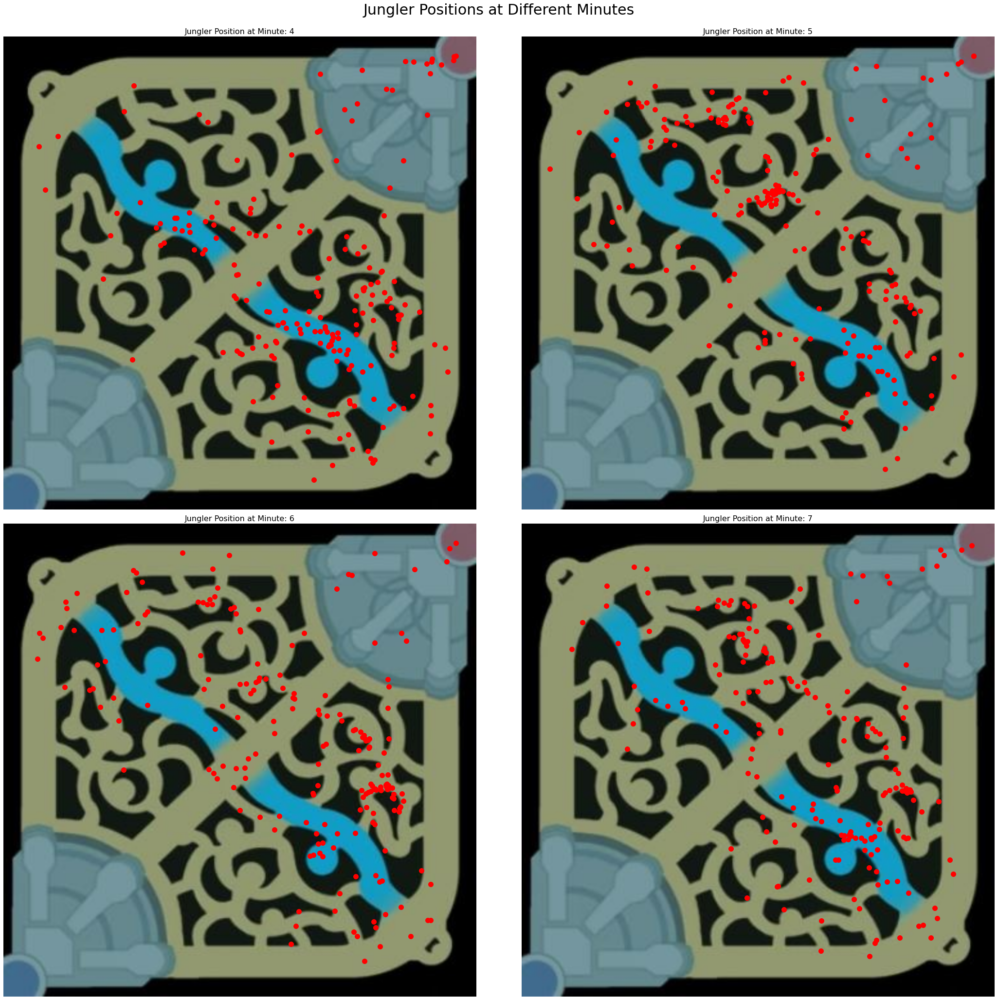

In [19]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [4, 5, 6, 7]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in r_top_side_matchID:
            jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]

            jungler2_X = jungler2["Player7_X"].values / 10
            jungler2_X = jungler2_X[::60]
            jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
            jungler2_Y = jungler2_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler2_X):
                # Get data for the specific minute
                jungler2_X_minute = jungler2_X[minute]
                jungler2_Y_minute = jungler2_Y[minute]
                ax.scatter(jungler2_X_minute, jungler2_Y_minute, c="r", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

## Red Side Jungler Starting at Bottom Side

Minute 0 to minute 7

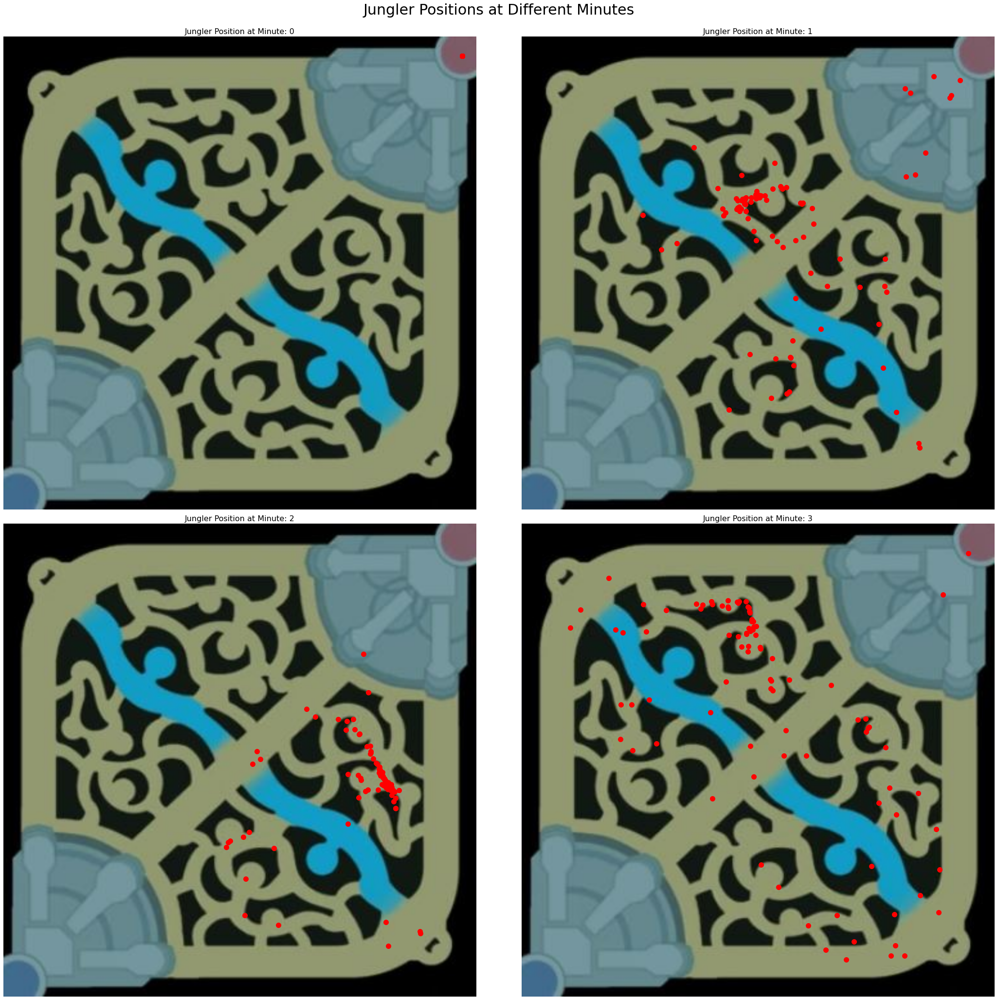

In [20]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [0, 1, 2, 3]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in r_bot_side_matchID:
            jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]

            jungler2_X = jungler2["Player7_X"].values / 10
            jungler2_X = jungler2_X[::60]
            jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
            jungler2_Y = jungler2_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler2_X):
                # Get data for the specific minute
                jungler2_X_minute = jungler2_X[minute]
                jungler2_Y_minute = jungler2_Y[minute]
                ax.scatter(jungler2_X_minute, jungler2_Y_minute, c="r", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

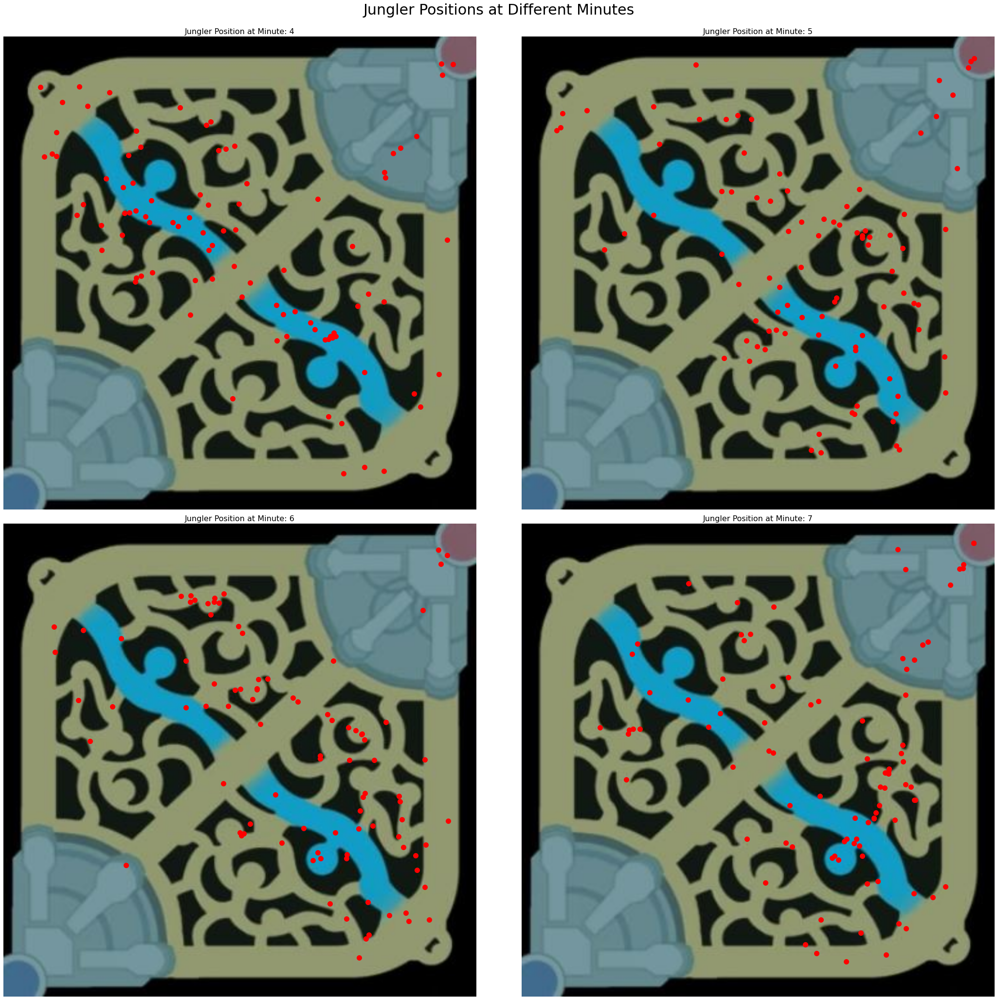

In [21]:
import matplotlib.pyplot as plt
import cv2

img = cv2.imread("./images/summoners-rift.jpg")

rgbimg = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
rbgimgresized = cv2.resize(rgbimg, (1500, 1500))


# Define the minutes you want to plot
minutes = [4, 5, 6, 7]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(30, 30))

for j, minute in enumerate(minutes):
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]
        ax.imshow(rbgimgresized)

        for match in r_bot_side_matchID:
            jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]

            jungler2_X = jungler2["Player7_X"].values / 10
            jungler2_X = jungler2_X[::60]
            jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
            jungler2_Y = jungler2_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            if minute < len(jungler2_X):
                # Get data for the specific minute
                jungler2_X_minute = jungler2_X[minute]
                jungler2_Y_minute = jungler2_Y[minute]
                ax.scatter(jungler2_X_minute, jungler2_Y_minute, c="r", s=100)


        ax.set_title(f"Jungler Position at Minute: {minute}", fontdict={'fontsize':16})
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
# Adjust layout and show the plots
plt.tight_layout(rect=[0,0.03,1,.98])
plt.show()

# Jungler Heatmaps

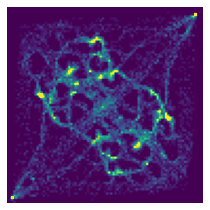

In [49]:
x = int(rbgimgresized.shape[1] / 16)
y = int(rbgimgresized.shape[0] / 16)
heatmap = np.zeros((y,x))
len(heatmap)

for match in uniqueMatchID:
    # print(match)
    jungler1 = df[df["MatchID"] == match][["Player2_X","Player2_Y"]]
    jungler2 = df[df["MatchID"] == match][["Player7_X","Player7_Y"]]
    jungler1_X = jungler1["Player2_X"].values/10
    jungler1_X = jungler1_X[::60]
    jungler1_Y = 1500 - (jungler1["Player2_Y"].values/10)
    jungler1_Y = jungler1_Y[::60]
    # separate
    jungler2_X = jungler2["Player7_X"].values/10
    jungler2_X = jungler2_X[::60]
    jungler2_Y = 1500 - (jungler2["Player7_Y"].values/10)
    jungler2_Y = jungler2_Y[::60]

    for i in range(1, len(jungler1_X)):
        jungler1_X_divised = jungler1_X[i] / 16
        jungler1_Y_divised = jungler1_Y[i] / 16

        jungler2_X_divised = jungler2_X[i] / 16
        jungler2_Y_divised = jungler2_Y[i] / 16

        heatmap[int(jungler1_X_divised),int(jungler1_Y_divised)] += 1
        heatmap[int(jungler2_X_divised),int(jungler2_Y_divised)] += 1

    

heatmap = heatmap.T
plt.imshow(heatmap, vmin = 0, vmax = 20)
plt.axis('off')
plt.gca().set_position((0,0,1,1))
plt.margins(x=0)
plt.tight_layout()
plt.savefig("./images/output/allmatchesgraph.png", bbox_inches='tight', pad_inches = 0)



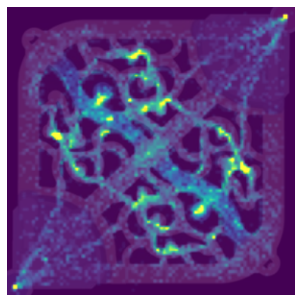

In [50]:
import cv2
mapimg = cv2.imread("./images/summoners-rift.jpg")
rgbmapimg = cv2.cvtColor(mapimg, cv2.COLOR_BGR2RGB)
rbgmapimgresized = cv2.resize(rgbmapimg, (300, 300))

heatmapimg = cv2.imread("./images/output/allmatchesgraph.png")
heatmapimg = cv2.cvtColor(heatmapimg, cv2.COLOR_BGR2RGB)
heatmapimg = cv2.resize(heatmapimg, (300, 300))
super_imposed_img = cv2.addWeighted(heatmapimg, 1, rbgmapimgresized, 0.2, 0)

plt.figure(figsize = (4, 4))
plt.imshow(super_imposed_img)
plt.gca().set_position((0,0,1,1))
plt.axis('off')
plt.savefig("./images/output/allmatchesgraph_superimposed.png", bbox_inches='tight', pad_inches = 0)

Since positions in League of Legends are very unlikely to be in the exact same coordinates, the coordinates are divided and set to an artificial maximum strength of 20 for the vmax. If vmax is set to the highest of the overlapping values the heatmap becomes very difficult to read as seen below.

(-0.5, 92.5, 92.5, -0.5)

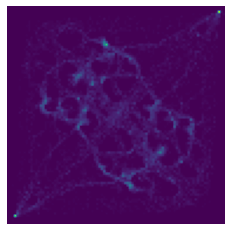

In [24]:

plt.imshow(heatmap,vmin=0,vmax=np.max(np.unique(heatmap)))
plt.axis('off')

[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17.
 18. 19. 20. 21. 22. 23. 24. 25. 26. 27. 28. 29. 30. 32. 35. 37. 39. 58.
 70. 83.]


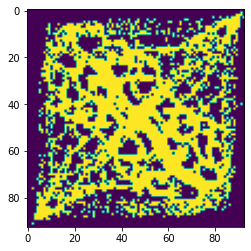

In [25]:
print(np.unique(heatmap))
plt.imshow(heatmap>0)

## Red Side Heatmaps

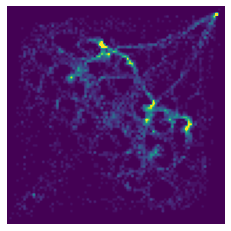

In [54]:
x = int(rbgimgresized.shape[1] / 16)
y = int(rbgimgresized.shape[0] / 16)
heatmap = np.zeros((y,x))


for match in uniqueMatchID:
        jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]

        jungler2_X = jungler2["Player7_X"].values / 10
        jungler2_X = jungler2_X[::60]
        jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
        jungler2_Y = jungler2_Y[::60]

        for i in range(1, len(jungler2_X)):

            jungler2_X_divised = jungler2_X[i] / 16
            jungler2_Y_divised = jungler2_Y[i] / 16
            heatmap[int(jungler2_X_divised),int(jungler2_Y_divised)] += 1

heatmap = np.flip(heatmap)
plt.imshow(heatmap, vmin = 0, vmax = 20)
plt.axis('off')
plt.savefig("./images/output/redmatchesgraph.png", bbox_inches='tight', pad_inches = 0)


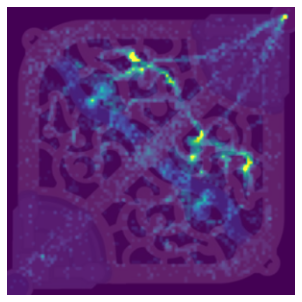

In [55]:
mapimg = cv2.imread("./images/summoners-rift.jpg")
rgbmapimg = cv2.cvtColor(mapimg, cv2.COLOR_BGR2RGB)
rbgmapimgresized = cv2.resize(rgbmapimg, (300, 300))

heatmapimg = cv2.imread("./images/output/redmatchesgraph.png")
heatmapimg = cv2.cvtColor(heatmapimg, cv2.COLOR_BGR2RGB)
heatmapimg = cv2.resize(heatmapimg, (300, 300))
super_imposed_img = cv2.addWeighted(heatmapimg, 1, rbgmapimgresized, 0.2, 0)

plt.figure(figsize = (4, 4))
plt.imshow(super_imposed_img)
plt.gca().set_position((0,0,1,1))
plt.axis('off')
plt.savefig("./images/output/redmatchesgraph_superimposed.png", bbox_inches='tight', pad_inches = 0)

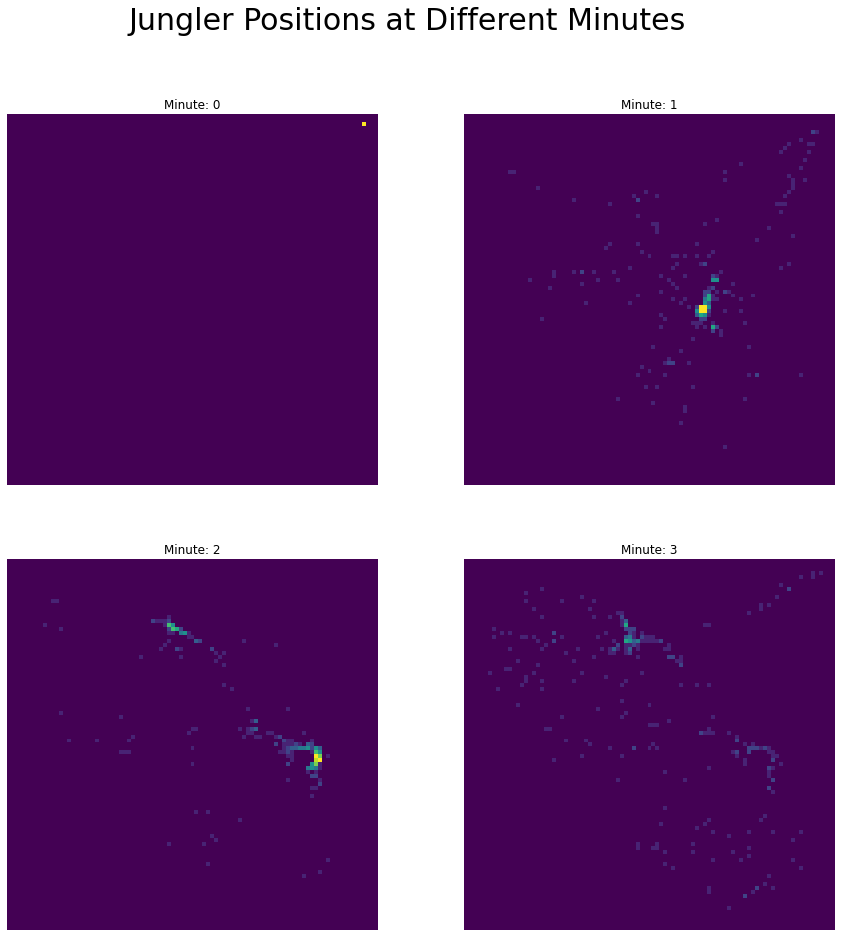

In [27]:
x = int(rbgimgresized.shape[1] / 16)
y = int(rbgimgresized.shape[0] / 16)
heatmap = np.zeros((y,x))

# Define the minutes you want to plot
minutes = [0, 1, 2, 3]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(15, 15))

for j, minute in enumerate(minutes):
    heatmap = np.zeros((y,x))
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]

        for match in uniqueMatchID:
            jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]

            jungler2_X = jungler2["Player7_X"].values / 10
            jungler2_X = jungler2_X[::60]
            jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
            jungler2_Y = jungler2_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            
            if minute < len(jungler2_X):
                # Get data for the specific minute
                jungler2_X_minute = jungler2_X[minute] / 16
                jungler2_Y_minute = jungler2_Y[minute] / 16
                heatmap[int(jungler2_X_minute),int(jungler2_Y_minute)] += 1
                
        heatmap = np.flip(heatmap)
        ax.imshow(heatmap, vmin = 0, vmax = 10)
        ax.set_title(f"Minute: {minute}")
        ax.axis('off')

heatmap = np.flip(heatmap)
plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
plt.show()

    

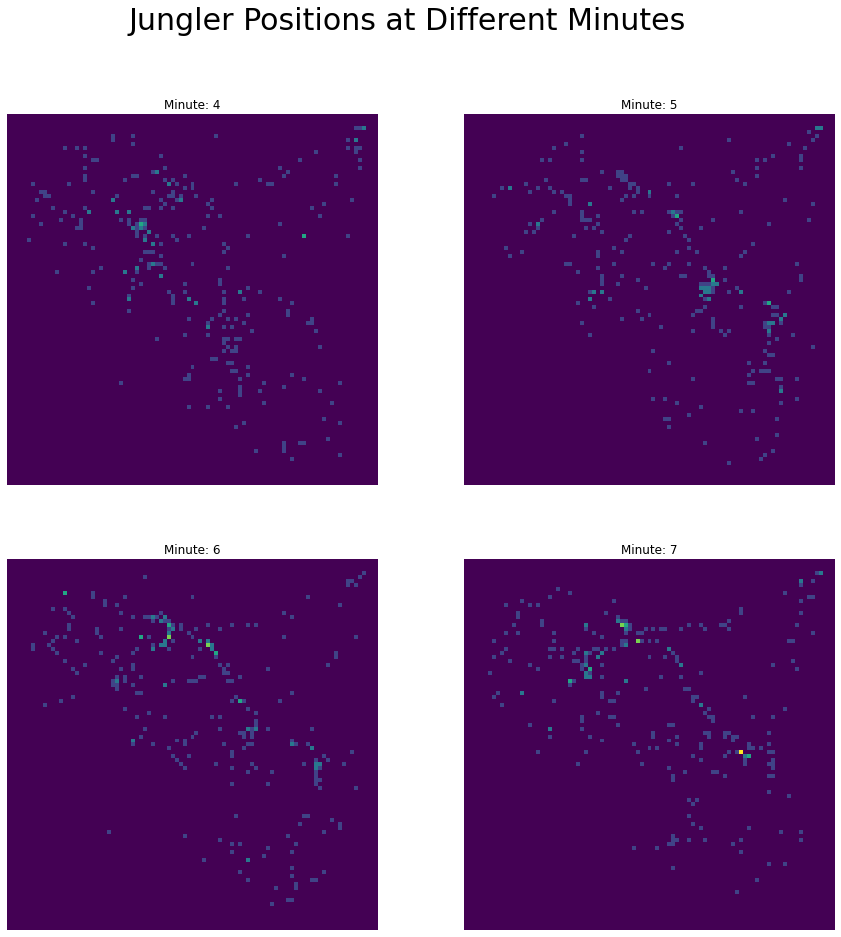

In [51]:
x = int(rbgimgresized.shape[1] / 16)
y = int(rbgimgresized.shape[0] / 16)
heatmap = np.zeros((y,x))

# Define the minutes you want to plot
minutes = [4, 5, 6, 7]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(15, 15))

for j, minute in enumerate(minutes):
    heatmap = np.zeros((y,x))
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]

        for match in uniqueMatchID:
            jungler2 = df[df["MatchID"] == match][["Player7_X", "Player7_Y"]]

            jungler2_X = jungler2["Player7_X"].values / 10
            jungler2_X = jungler2_X[::60]
            jungler2_Y = 1500 - (jungler2["Player7_Y"].values / 10)
            jungler2_Y = jungler2_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            
            if minute < len(jungler2_X):
                # Get data for the specific minute
                jungler2_X_minute = jungler2_X[minute] / 16
                jungler2_Y_minute = jungler2_Y[minute] / 16
                heatmap[int(jungler2_X_minute),int(jungler2_Y_minute)] += 1
                
        heatmap = np.flip(heatmap)
        ax.imshow(heatmap, vmin = 0, vmax = 5)
        ax.set_title(f"Minute: {minute}")
        ax.axis('off')

heatmap = np.flip(heatmap)
plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
plt.show()

## Blue Side Heatmaps

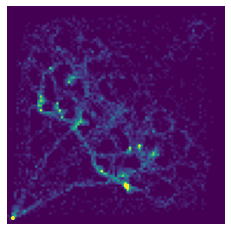

In [56]:
x = int(rbgimgresized.shape[1] / 16)
y = int(rbgimgresized.shape[0] / 16)
heatmap = np.zeros((y,x))


for match in uniqueMatchID:
        jungler1 = df[df["MatchID"] == match][["Player2_X", "Player2_Y"]]

        jungler1_X = jungler1["Player2_X"].values / 10
        jungler1_X = jungler1_X[::60]
        jungler1_Y = 1500 - (jungler1["Player2_Y"].values / 10)
        jungler1_Y = jungler1_Y[::60]

        for i in range(1, len(jungler1_X)):
            jungler1_X_divised = jungler1_X[i] / 16
            jungler1_Y_divised = jungler1_Y[i] / 16
            heatmap[int(jungler1_X_divised),int(jungler1_Y_divised)] += 1

heatmap = np.flip(heatmap)
plt.imshow(heatmap, vmin = 0, vmax = 20)
plt.axis('off')
plt.savefig("./images/output/bluematchesgraph.png", bbox_inches='tight')

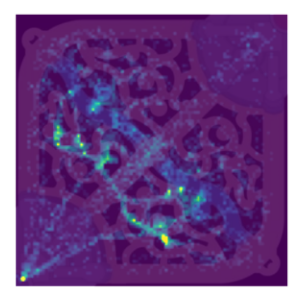

In [57]:
mapimg = cv2.imread("./images/summoners-rift.jpg")
rgbmapimg = cv2.cvtColor(mapimg, cv2.COLOR_BGR2RGB)
rbgmapimgresized = cv2.resize(rgbmapimg, (300, 300))

heatmapimg = cv2.imread("./images/output/bluematchesgraph.png")
heatmapimg = cv2.cvtColor(heatmapimg, cv2.COLOR_BGR2RGB)
heatmapimg = cv2.resize(heatmapimg, (300, 300))
super_imposed_img = cv2.addWeighted(heatmapimg, 1, rbgmapimgresized, 0.2, 0)

plt.figure(figsize = (4, 4))
plt.imshow(super_imposed_img)
plt.gca().set_position((0,0,1,1))
plt.axis('off')
plt.savefig("./images/output/bluematchesgraph_superimposed.png", bbox_inches='tight', pad_inches = 0)

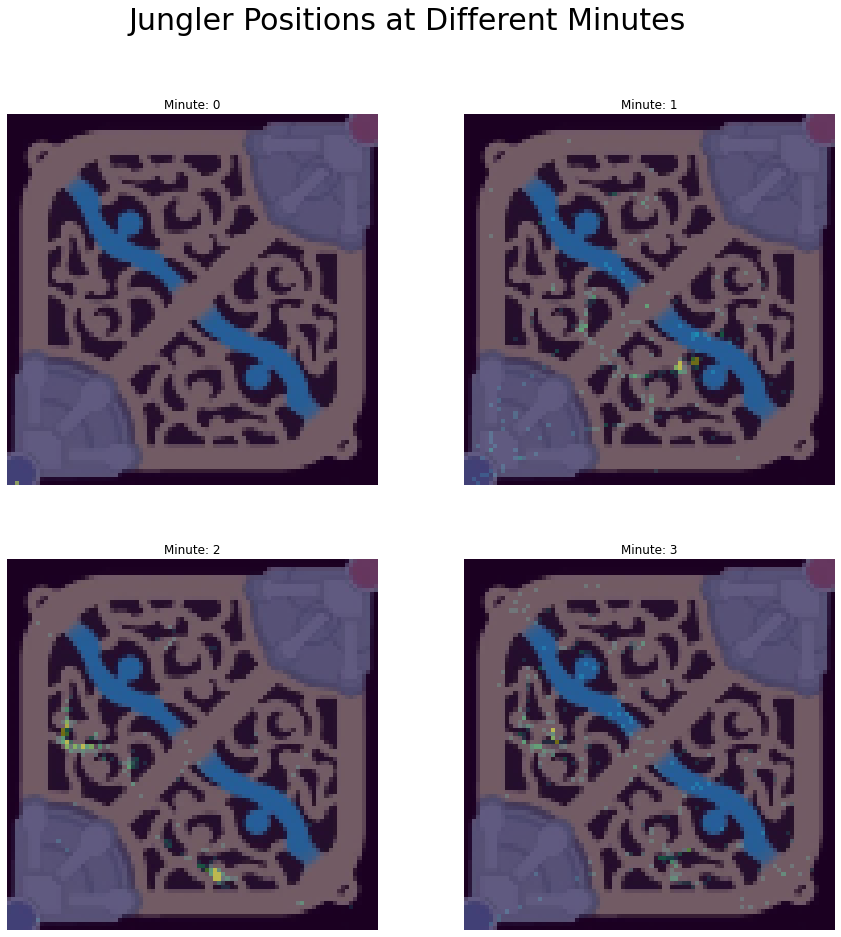

In [66]:
x = int(rbgimgresized.shape[1] / 16)
y = int(rbgimgresized.shape[0] / 16)
heatmap = np.zeros((y,x))

rbgsubplotsize = cv2.resize(rbgmapimgresized, (90, 90))
# Define the minutes you want to plot
minutes = [0, 1, 2, 3]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(15, 15))

for j, minute in enumerate(minutes):
    heatmap = np.zeros((y,x))
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]

        for match in uniqueMatchID:
            jungler1 = df[df["MatchID"] == match][["Player2_X", "Player2_Y"]]

            jungler1_X = jungler1["Player2_X"].values / 10
            jungler1_X = jungler1_X[::60]
            jungler1_Y = 1500 - (jungler1["Player2_Y"].values / 10)
            jungler1_Y = jungler1_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            
            if minute < len(jungler1_X):
                # Get data for the specific minute
                jungler1_X_minute = jungler1_X[minute] / 16
                jungler1_Y_minute = jungler1_Y[minute] / 16
                heatmap[int(jungler1_X_minute),int(jungler1_Y_minute)] += 1
                
        heatmap = np.flip(heatmap)
        ax.imshow(heatmap, vmin = 0, vmax = 5)
        
        ax.imshow(rbgsubplotsize, alpha = 0.6)
        ax.set_title(f"Minute: {minute}")
        ax.axis('off')

plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
plt.show()

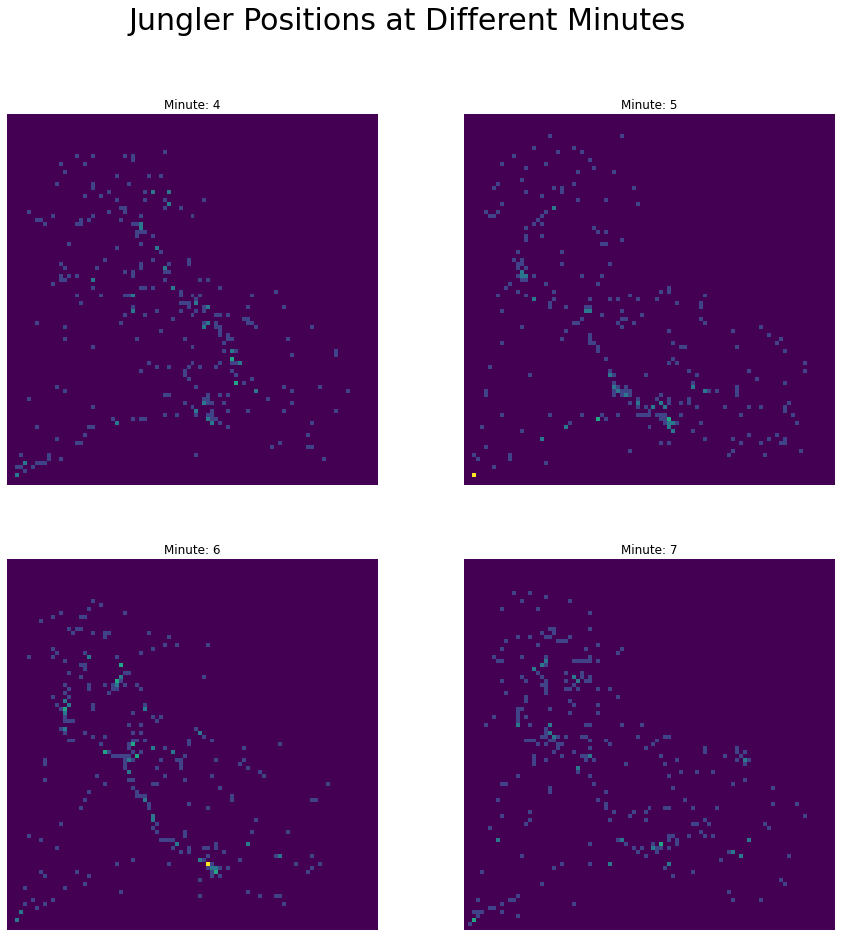

In [52]:
x = int(rbgimgresized.shape[1] / 16)
y = int(rbgimgresized.shape[0] / 16)
heatmap = np.zeros((y,x))

# Define the minutes you want to plot
minutes = [4, 5, 6, 7]

# Create subplots
num_plots = len(minutes)
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(15, 15))

for j, minute in enumerate(minutes):
    heatmap = np.zeros((y,x))
    if j < 4:  # Only iterate for the available subplots (0 to 3)
        row = j // 2
        col = j % 2
        ax = axs[row, col]

        for match in uniqueMatchID:
            jungler1 = df[df["MatchID"] == match][["Player2_X", "Player2_Y"]]

            jungler1_X = jungler1["Player2_X"].values / 10
            jungler1_X = jungler1_X[::60]
            jungler1_Y = 1500 - (jungler1["Player2_Y"].values / 10)
            jungler1_Y = jungler1_Y[::60]

            # Ensure the index is within bounds if game is short due to a disconnected player or remake
            
            if minute < len(jungler1_X):
                # Get data for the specific minute
                jungler1_X_minute = jungler1_X[minute] / 16
                jungler1_Y_minute = jungler1_Y[minute] / 16
                heatmap[int(jungler1_X_minute),int(jungler1_Y_minute)] += 1
                
        heatmap = np.flip(heatmap)
        ax.imshow(heatmap, vmin = 0, vmax = 5)
        ax.set_title(f"Minute: {minute}")
        ax.axis('off')

heatmap = np.flip(heatmap)
plt.suptitle("Jungler Positions at Different Minutes", fontsize = 30)
plt.show()